## Build MRCNN Model
Pass data through MRCNN and then FCN and investigte output values from FCN
- First we generate the heatmaps, and also visually cehck them. 
- the we pass the heatmaps to the routine that prodcues the scores 

In [5]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))
%matplotlib inline
%load_ext autoreload
%autoreload 2
import sys, os, random, pprint
sys.path.append('../../')
import tensorflow          as tf
import keras.backend       as KB
import numpy               as np
from mrcnn.datagen         import data_generator, load_image_gt, data_gen_simulate
from mrcnn.callbacks       import get_layer_output_1,get_layer_output_2
from mrcnn.utils           import mask_string, parse_image_meta, apply_box_deltas_tf, log
from mrcnn.visualize       import display_gt_bboxes, display_roi_proposals, plot_3d_heatmap 
from mrcnn.visualize       import display_gt_bboxes, display_roi_proposals
from mrcnn.prep_notebook   import mrcnn_coco_train, prep_coco_dataset
from mrcnn.coco            import CocoDataset, CocoConfig, CocoInferenceConfig, evaluate_coco, build_coco_results

import mrcnn.visualize     as visualize
from mrcnn.visualize       import (plot_one_bbox_heatmap, 
                             plot_3d_heatmap, plot_2d_heatmap, 
                             plot_2d_heatmap_compare, plot_3d_heatmap_compare)
import matplotlib as plt
%matplotlib inline

import mrcnn.model_fcn     as fcn_modellib
import mrcnn.model_mrcnn   as mrcnn_modellib
import mrcnn.utils         as utils

pp = pprint.PrettyPrinter(indent=2, width=100)
np.set_printoptions(linewidth=100,precision=4,threshold=1000, suppress = True)

mrcnn_model, mrcnn_config = mrcnn_coco_train(mode = 'trainfcn')

##  Build FCN Model 

####  FCN configuration

from mrcnn.utils import Paths
paths = Paths(fcn_training_folder='train_fcn8_coco')
paths.display()
##------------------------------------------------------------------------------------
## Build configuration for FCN model
##------------------------------------------------------------------------------------
fcn_config = CocoConfig()
# fcn_config.IMAGE_MAX_DIM        = 600
# fcn_config.IMAGE_MIN_DIM        = 480      
# mrcnn_config.COCO_DATASET_PATH  = COCO_DATASET_PATH 
# mrcnn_config.COCO_MODEL_PATH    = COCO_MODEL_PATH   
# mrcnn_config.RESNET_MODEL_PATH  = RESNET_MODEL_PATH 
fcn_config.NAME                 = 'fcn'              
fcn_config.TRAINING_PATH        = paths.FCN_TRAINING_PATH
fcn_config.VGG16_MODEL_PATH     = paths.FCN_VGG16_MODEL_PATH
fcn_config.FCN_INPUT_SHAPE      = mrcnn_config.IMAGE_SHAPE[0:2] // mrcnn_config.HEATMAP_SCALE_FACTOR 

fcn_config.BATCH_SIZE           = mrcnn_config.BATCH_SIZE                # Batch size is 2 (# GPUs * images/GPU).
fcn_config.IMAGES_PER_GPU       = mrcnn_config.BATCH_SIZE                  # Must match BATCH_SIZE
fcn_config.EPOCHS_TO_RUN        = 1
fcn_config.STEPS_PER_EPOCH      = 4
fcn_config.LAST_EPOCH_RAN       = 0

fcn_config.LEARNING_RATE        = 0.0001 

fcn_config.BATCH_MOMENTUM       = 0.9
fcn_config.WEIGHT_DECAY         = 2.0e-4
fcn_config.REDUCE_LR_FACTOR     = 0.5
fcn_config.REDUCE_LR_COOLDOWN   = 5
fcn_config.REDUCE_LR_PATIENCE   = 5
fcn_config.EARLY_STOP_PATIENCE  = 15
fcn_config.EARLY_STOP_MIN_DELTA = 1.0e-4
fcn_config.MIN_LR               = 1.0e-10
 
fcn_config.VALIDATION_STEPS     = 5
fcn_config.REDUCE_LR_FACTOR     = 0.5
fcn_config.REDUCE_LR_COOLDOWN   = 50
fcn_config.REDUCE_LR_PATIENCE   = 33
fcn_config.EARLY_STOP_PATIENCE  = 50
fcn_config.EARLY_STOP_MIN_DELTA = 1.0e-6
fcn_config.MIN_LR               = 1.0e-10
fcn_config.NEW_LOG_FOLDER       = True  
fcn_config.OPTIMIZER            = 'ADAGRAD'
fcn_config.SYSOUT               = 'screen'

fcn_config.display()

#### Build FCN Model

##------------------------------------------------------------------------------------
## Build FCN Model in Training Mode
##------------------------------------------------------------------------------------
try :
    del fcn_model
    gc.collect()
except: 
    pass    
fcn_model = fcn_modellib.FCN(mode="training", arch = 'FCN8', config=fcn_config)

####  Display FCN model info

# fcn_model.config.display()  
fcn_model.layer_info()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
>>> Initialize Paths
 Linx  Linux

Paths:
-------------------------
COCO_DATASET_PATH              /home/kbardool/MLDatasets/coco2014
COCO_HEATMAP_PATH              /home/kbardool/MLDatasets/coco2014_heatmaps
COCO_MODEL_PATH                /home/kbardool/PretrainedModels/mask_rcnn_coco.h5
DIR_DATASET                    /home/kbardool/MLDatasets
DIR_PRETRAINED                 /home/kbardool/PretrainedModels
DIR_ROOT                       /home/kbardool/git_projs/mrcnn3/notebooks/ADAM_Training
DIR_TRAINING                   /home/kbardool/models
FCN_TRAINING_PATH              /home/kbardool/models/train_fcn_coco
FCN_VGG16_MODEL_PATH           /home/kbardool/PretrainedModels/fcn_vgg16_weights_tf_dim_ordering_tf_kernels.h5
MRCNN_TRAINING_PATH            /home/kbardool/models/train_mrcnn_coco
RESNET_MODEL_PATH              /home/kbardool/PretrainedModels/resnet50_weights_tf_dim_ordering_tf_kernels_notop.


    normalization ------------------------------------------------------
    normalizer     :  (?, 1, 1)
    prob_grid_norm_scaled :  (?, 256, 256)

    Scatter out the probability distributions based on class --------------
    pt2_ind shape      :  (?, 3)
    prob_grid_clippped :  (?, 256, 256)
    gauss_heatmap      :  (1, 81, 200, 256, 256)

    Reduce sum based on class ---------------------------------------------
    gaussian_heatmap :  (1, 81, 256, 256) Keras tensor  False

    normalization ------------------------------------------------------
    normalizer shape   :  (1, 81, 1, 1)
    normalized heatmap :  (1, 81, 256, 256)  Keras tensor  False
    reshaped heatmap :  (1, 256, 256, 81)  Keras tensor  False
    complete

    pred_refined_heatmap        :  (1, 256, 256, 81) Keras tensor  False
    pred_refnined_heatmap_scores:  (1, 81, 200, 11) Keras tensor  False
    complete

-----------------------------------------
>>>  CHM Layer (Ground Truth Generation) 
--------------

   FCN Block 31 shape is               :  (None, 64, 64, 256)
   FCN Block 32 shape is               :  (None, 64, 64, 256)
   FCN Block 33 shape is               :  (None, 64, 64, 256)
   FCN Block 34 (Max pooling) shape is :  (?, 32, 32, 256)
   FCN Block 41 shape is               :  (None, 32, 32, 512)
   FCN Block 42 shape is               :  (None, 32, 32, 512)
   FCN Block 43 shape is               :  (None, 32, 32, 512)
   FCN Block 44 (Max pooling) shape is :  (?, 16, 16, 512)
   FCN Block 51 shape is               :  (None, 16, 16, 512)
   FCN Block 52 shape is               :  (None, 16, 16, 512)
   FCN Block 53 shape is               :  (None, 16, 16, 512)
   FCN Block 54 (Max pooling) shape is :  (None, 8, 8, 512)

   --- FCN32 ----------------------------
   FCN fully connected 1 (fc1) shape   :  (None, 8, 8, 4096)
   FCN fully connected 2 (fc2) shape   :  (None, 8, 8, 4096)
   FCN conv2d (fcn32_deconv2D) shape   :  (?, 8, 8, 81)  keras_tensor  True

   --- FCN16 ---------

## Load MRCNN and FCN weights (FCN weights if not starting from init mode)

In [6]:
# exclude=["mrcnn_class_logits"] # ,"mrcnn_bbox_fc"]   #, "mrcnn_bbox", "mrcnn_mask"])
mrcnn_model.load_model_weights(init_with = 'last', exclude = None)  

#### FCN

##------------------------------------------------------------------------------------
## Load FCN Model weights  
##------------------------------------------------------------------------------------
# fcn_model.load_model_weights(init_with = 'last') # 'fcn_config.VGG16_MODEL_PATH')
# WEIGHT_FILE = '/home/kbardool/models/train_fcn8_coco/fcn20181028T0000/fcn_0050.h5'  # <--- With L2
# WEIGHT_FILE = '/home/kbardool/models/train_fcn8_coco/fcn20181030T0000/fcn_0248.h5' # <--- Partial L2 (some still remaining)
WEIGHT_FILE = '/home/kbardool/models/train_fcn8_coco_adam/fcn20181108T0000/fcn_0073.h5'
fcn_model.load_model_weights(init_with =WEIGHT_FILE, verbose = 1)


-----------------------------------------------
 Load Model with init parm: [ last ]
-----------------------------------------------
 ---> last
>>> find_last checkpoint in :  /home/kbardool/models/train_mrcnn_coco
    Dir starting with  mrcnn  : ['mrcnn20181105T1801', 'mrcnn20181107T1443', 'mrcnn20181107T1450', 'mrcnn20181105T1811', 'mrcnn20181105T1813', 'mrcnn20181011T1100']
    find_last():   dir_name: /home/kbardool/models/train_mrcnn_coco/mrcnn20181011T1100
    find_last(): checkpoint: /home/kbardool/models/train_mrcnn_coco/mrcnn20181011T1100/mrcnn_0103.h5
>>> load_weights() from : /home/kbardool/models/train_mrcnn_coco/mrcnn20181011T1100/mrcnn_0103.h5
layers type:  <class 'list'> length:  383
    Weights file loaded: /home/kbardool/models/train_mrcnn_coco/mrcnn20181011T1100/mrcnn_0103.h5 
MRCNN  MODEL Load weight file COMPLETE 
-----------------------------------------------
 Load Model with init parm: [ /home/kbardool/models/train_fcn8_coco_adam/fcn20181108T0000/fcn_0073.h5 ]
---

    Weights file loaded: /home/kbardool/models/train_fcn8_coco_adam/fcn20181108T0000/fcn_0073.h5 
FCN  MODEL Load weight file COMPLETE 


## Load Training Files and Display Images
 
     train
         image_ids[:10]       :  [262145, 262146, 524291, 131074, 393221, 131075, 393223, 393224, 524297, 9]
         image_ids[1000:1010] :  [1451, 132523, 1453, 132527, 263599, 132529, 132528, 263603, 263604, 132533]
     val35k
      image_ids[:10]       :  [262148, 393225, 131089, 262161, 262162, 393243, 262175, 131108, 393254, 42]
      image_ids[1000:1010] :  [134290, 527506, 527504, 134288, 527510, 265372, 265374, 265378, 527529, 3244]

In [7]:
# dataset_train, train_generator  = prep_coco_dataset(['train','val35k'], mrcnn_config, generator = True)
dataset_train, train_generator  = prep_coco_dataset(['train','val35k'], mrcnn_config, generator = True, shuffle = False, augment = False)
# dataset_val, val_generator      = prep_coco_dataset(['minival'], mrcnn_config, generator = True) 
class_names = dataset_train.class_names

loading annotations into memory...
Done (t=13.55s)
creating index...
index created!
 image dir            :  /home/kbardool/MLDatasets/coco2014/train2014
 json_path_dir        :  /home/kbardool/MLDatasets/coco2014/annotations/instances_train2014.json
 number of images     :  82081
 image_ids[:10]       :  [262145, 262146, 524291, 131074, 393221, 131075, 393223, 393224, 524297, 9]
 image_ids[1000:1010] :  [1451, 132523, 1453, 132527, 263599, 132529, 132528, 263603, 263604, 132533]
loading annotations into memory...
Done (t=8.78s)
creating index...
index created!
 image dir            :  /home/kbardool/MLDatasets/coco2014/val2014
 json_path_dir        :  /home/kbardool/MLDatasets/coco2014/annotations/instances_valminusminival2014.json
 number of images     :  35185
 image_ids[:10]       :  [262148, 393225, 131089, 262161, 262162, 393243, 262175, 131108, 393254, 42]
 image_ids[1000:1010] :  [134290, 527506, 527504, 134288, 527510, 265372, 265374, 265378, 527529, 3244]


####  Display next image from generator

In [10]:
train_batch_x, train_batch_y = next(train_generator)

/home/kbardool/anaconda3/envs/TFG/lib/python3.5/site-packages/scipy/ndimage/interpolation.py:616: UserWarning: From scipy 0.13.0, the output shape of zoom() is calculated with round() instead of int() - for these inputs the size of the returned array has changed.
  "the returned array has changed.", UserWarning)


Image id:  2
Image meta [   2  426  640    3  171    0  853 1024    1    1    1    1    1    1    1    1    1    1    1
    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1
    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1
    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1    1
    1    1    1    1    1    1    1    1    1    1    1    1    1]


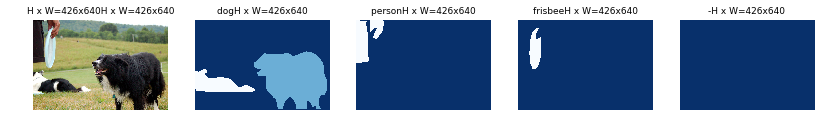

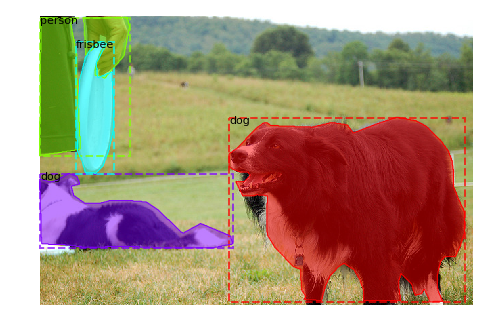

In [11]:
class_names = dataset_train.class_names
imgmeta_idx = mrcnn_model.keras_model.input_names.index('input_image_meta')
img_meta    = train_batch_x[imgmeta_idx]

for img_idx in range(mrcnn_config.BATCH_SIZE):
    image_id = img_meta[img_idx,0]
    image = dataset_train.load_image(image_id)
    mask, class_ids = dataset_train.load_mask(image_id)
    bbox = utils.extract_bboxes(mask)
    print('Image id: ',image_id)
    print('Image meta', img_meta[img_idx])
#     print('Classes (1: circle, 2: square, 3: triangle ): ',class_ids)
    visualize.display_top_masks(image, mask, class_ids, dataset_train.class_names)
    visualize.display_instances_with_mask(image, bbox, mask, class_ids, dataset_train.class_names, figsize =(8,8))  

#### Load a specific image using image_id

 batch size is : 1
 load image ud:  26763
 Dataset coco file: 169322
 Image meta  :  [26763   480   640     3   128     0   896  1024     1     1]
 Classes     :  [57 57 61 43 42 46 40 74]
 Image_id    :  26763  Reference:  http://cocodataset.org/#explore?id=169322
 Class_ids.shape[0]: 8 bbox.shape[0]: 8
 Class Names :  ['chair', 'chair', 'dining table', 'fork', 'cup', 'bowl', 'bottle', 'book']


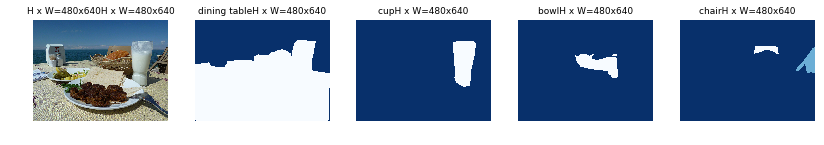

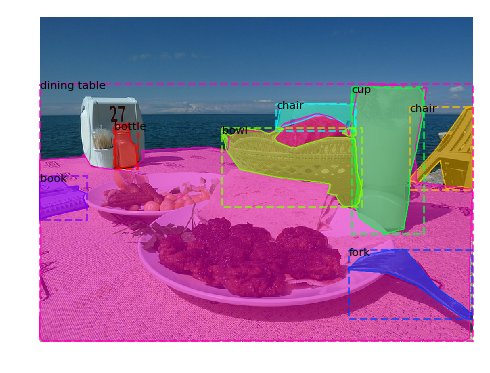

In [12]:
## 62642 (persons),   68539 (trucks) 36466 (surfers)  75040 (boat and persons)
## 36466 surfers. 5498 basketbal players, 27711,30531
## 5498 lots of motorcylces & persons - 
## Persons: #26026, #7719, 111864, 58240,  
## 89243: Person, bicylce and traiffic lights
## 35347 - laptops, keyboards and cat
## items = [59199 , 102868]
## 101623 (cake and forks), 41423 (elephant & people)
## 33477 Table, bowl, cup, sandwich, knife
## 26763 Table, chair, cup , bowl, bottle
## 49316 Table, book, backpack, many bottles
# train_batch_x, train_batch_y = next(train_generator)
# IMAGE_LIST = [75040] 
# IMAGE_LIST = [89243]
# IMAGE_LIST = [33477]
# IMAGE_LIST = [29731]
IMAGE_LIST = [26763]
train_batch_x, train_batch_y = test_batch_x, test_batch_y = data_gen_simulate(dataset_train, mrcnn_config, IMAGE_LIST)
imgmeta_idx = mrcnn_model.keras_model.input_names.index('input_image_meta')
img_meta    = train_batch_x[imgmeta_idx]

for img_idx in range(mrcnn_config.BATCH_SIZE):
    image_id = img_meta[img_idx,0]
    image = dataset_train.load_image(image_id)
    mask, class_ids = dataset_train.load_mask(image_id)
    bbox = utils.extract_bboxes(mask)
    class_names = [str(dataset_train.class_names[class_id]) for class_id in class_ids]
    print(' Dataset coco file:', dataset_train.image_info[image_id]['id'])
    print(' Image meta  : ', img_meta[img_idx,:10])
    print(' Classes     : ', class_ids)
    print(" Image_id    : ", image_id, ' Reference: ', dataset_train.image_reference(image_id))
    print(' Class_ids.shape[0]:', class_ids.shape[0], 'bbox.shape[0]:',bbox.shape[0])       
    print(' Class Names : ', class_names)
    
    visualize.display_top_masks(image, mask, class_ids, dataset_train.class_names)   
    # Display image and instances
    visualize.display_instances_with_mask(image, bbox, mask, class_ids, dataset_train.class_names, figsize =(8,8))    

## Pass image through MRCNN and FCN

###  Pass data thru MRCNN model - Load In/Out Data - Pass through FCN

In [13]:
# mrcnn_model.layer_info()

# model_output = get_layer_output_2(model.keras_model, train_batch_x, 1)
model_output = get_layer_output_1(mrcnn_model.keras_model, train_batch_x, [0,1,2,3], 1)

### Load input / output data

print(len(model_output))
# del pred_heatmap_norm, pred_heatmap_scores, gt_heatmap, gt_heatmap_scores
model_pred_heatmap_norm         = model_output[0]          # layer:  0   shape: (1, 256, 256, 81)
model_pred_heatmap_scores       = model_output[1]          # layer:  1   shape: (1, 81, 200, 11)
model_gt_heatmap                = model_output[2]          # layer:  2   shape: (1, 256, 256, 81)
model_gt_heatmap_scores         = model_output[3]          # layer:  3   shape: (1, 81, 200, 11)

for i in model_output:
    print( i.shape)

# input_image      =  train_batch_x[0]
input_image_meta =  train_batch_x[1]
input_gt_bboxes  =  train_batch_x[5]
print(input_image_meta)

/* Inputs */
Input  0:  (input_image:0                           ) 	  Input shape: (1, 1024, 1024, 3)
Input  1:  (input_image_meta:0                      ) 	  Input shape: (1, 89)
Input  2:  (input_rpn_match:0                       ) 	  Input shape: (1, 261888, 1)
Input  3:  (input_rpn_bbox:0                        ) 	  Input shape: (1, 256, 4)
Input  4:  (input_gt_class_ids:0                    ) 	  Input shape: (1, 100)
Input  5:  (input_gt_boxes:0                        ) 	  Input shape: (1, 100, 4)

/* Outputs */
Output idx:  0    Layer:  0: (cntxt_layer/pred_heatmap_norm:0         ) 	  Output shape: (1, 256, 256, 81)
Output idx:  1    Layer:  1: (cntxt_layer/pred_heatmap_scores:0       ) 	  Output shape: (1, 81, 200, 11)
Output idx:  2    Layer:  2: (cntxt_layer_gt/gt_heatmap:0             ) 	  Output shape: (1, 256, 256, 81)
Output idx:  3    Layer:  3: (cntxt_layer_gt/gt_heatmap_scores:0      ) 	  Output shape: (1, 81, 200, 11)

Number of layers generated:  4 

pred_heatmap_norm

### Pass data through FCN

In [14]:
# fcn_model.layer_info()
fcn_train_batch_x = [train_batch_x[1]]
fcn_train_batch_x.extend(model_output[:4])
for i in fcn_train_batch_x:
    print(i.shape)
# fcn_train_batch_x = [model_pred_heatmap_norm, model_pred_heatmap_scores, model_gt_heatmap, model_gt_heatmap_scores]

fcn_model_output = get_layer_output_1(fcn_model.keras_model, fcn_train_batch_x, [0,1], 1)
 

model_fcn_heatmap               = fcn_model_output[0]          # layer:  0   shape: (1, 256, 256, 81)
model_Mean                      = fcn_model_output[1]          # layer:  1   shape: ()

# hm_sum = np.sum(model_fcn_heatmap, axis=(1,2))
print('heatmap loss: ',model_Mean)

(1, 89)
(1, 256, 256, 81)
(1, 81, 200, 11)
(1, 256, 256, 81)
(1, 81, 200, 11)
/* Inputs */
Input  0:  (input_image_meta_1:0                    ) 	  Input shape: (1, 89)
Input  1:  (input_pr_hm_norm:0                      ) 	  Input shape: (1, 256, 256, 81)
Input  2:  (input_pr_hm_scores:0                    ) 	  Input shape: (1, 81, 200, 11)
Input  3:  (input_gt_hm_norm:0                      ) 	  Input shape: (1, 256, 256, 81)
Input  4:  (input_gt_hm_scores:0                    ) 	  Input shape: (1, 81, 200, 11)

/* Outputs */
Output idx:  0    Layer:  0: (fcn8_heatmap/BiasAdd:0                  ) 	  Output shape: (1, 256, 256, 81)
Output idx:  1    Layer:  1: (fcn_MSE_loss/fcn_MSE_loss:0             ) 	  Output shape: (1, 1)

Number of layers generated:  2 

BiasAdd                   = model_output[0]          # layer:  0   shape: (1, 256, 256, 81)
fcn_MSE_loss              = model_output[1]          # layer:  1   shape: (1, 1)
heatmap loss:  [[0.0002]]


#### Display values from FCN_heatmap

In [ ]:
img_id = 0 
class_ids = np.unique(model_gt_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
for i in range(class_ids[-1]+1):
    
    print('FCN class: {:3d}   min: {:12.8f}    max: {:12.8f}    sum: {:12.8f} '.format(i, np.min(model_fcn_heatmap[0,:,:,i]), 
                                                                    np.max(model_fcn_heatmap[0,:,:,i]), 
                                                                    np.sum(model_fcn_heatmap[0,:,:,i])))
    print('GT  class: {:3d}   min: {:12.8f}    max: {:12.8f}    sum: {:12.8f} '.format(i, np.min(model_gt_heatmap[0,:,:,i]), 
                                                                    np.max(model_gt_heatmap[0,:,:,i]), 
                                                                    np.sum(model_gt_heatmap[0,:,:,i])))
    print()

In [ ]:
# print(model_fcn_heatmap[0,0:10,:10,1])

In [ ]:
# for i in range(10):
#     print(model_fcn_heatmap[0,i,:,4])
#     print(np.min(model_fcn_heatmap[0,i,:,1]), np.max(model_fcn_heatmap[0,i,:,1]))

## Display Heatmaps

In [15]:
# from mrcnn.visualize import (plot_one_bbox_heatmap, 
#                              plot_3d_heatmap, plot_2d_heatmap, 
#                              plot_3d_heatmap_all_classes, plot_2d_heatmap_all_classes,
#                              plot_2d_heatmap_compare, plot_3d_heatmap_compare)
# import matplotlib as plt
# %matplotlib inline
print('Image id: ',image_id, ' Coco ID: ', dataset_train.image_info[image_id]['id'])
img_id = 0
coco_class_names = dataset_train.class_names
print(model_fcn_heatmap.shape)

Image id:  26763  Coco ID:  169322
(1, 256, 256, 81)


### 2D Plots  

####  2D plot of `model_gt_heatmap` returned from model

(1, 256, 256, 81) (1, 81, 200, 11)
Image : 0  ClassIds: [0, 40, 42, 43, 46, 57, 61, 74]
Display classes: [0, 40, 42, 43, 46, 57, 61, 74]
class_ids: [0, 40, 42, 43, 46, 57, 61, 74]
rows   2  columns : 4


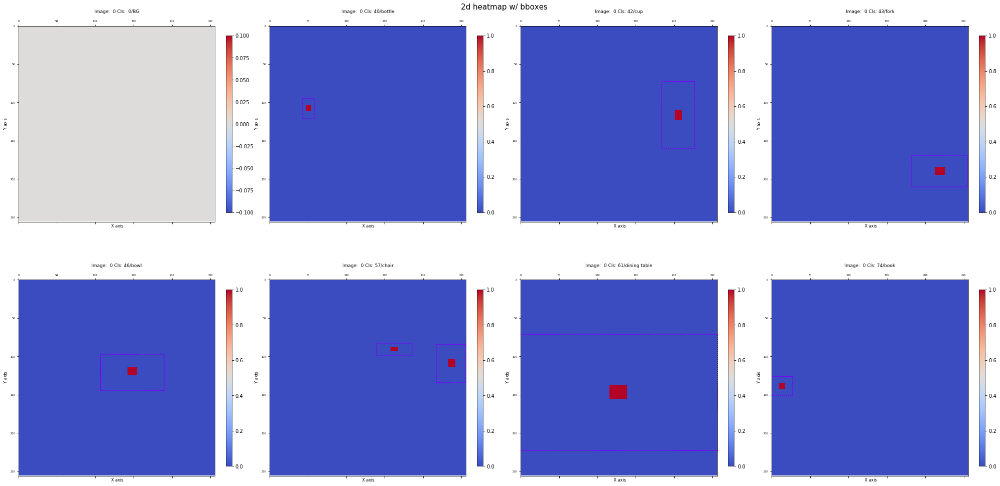

In [17]:
for img_id in [0]:     ##range(mrcnn_config.BATCH_SIZE):
    print(model_gt_heatmap.shape, model_gt_heatmap_scores.shape)
    class_ids = np.unique(model_gt_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
    plot_2d_heatmap(model_gt_heatmap, model_gt_heatmap_scores, img_id, class_ids, 
                     class_names = coco_class_names, columns = 4, scale = 4)

####  2D plot of `model_fcn_heatmap` returned from model

(1, 256, 256, 81)
Image : 0  ClassIds: [0, 40, 42, 43, 46, 57, 61, 74]
Display classes: [0, 40, 42, 43, 46, 57, 61, 74]
class_ids: [0, 40, 42, 43, 46, 57, 61, 74]
rows   2  columns : 4


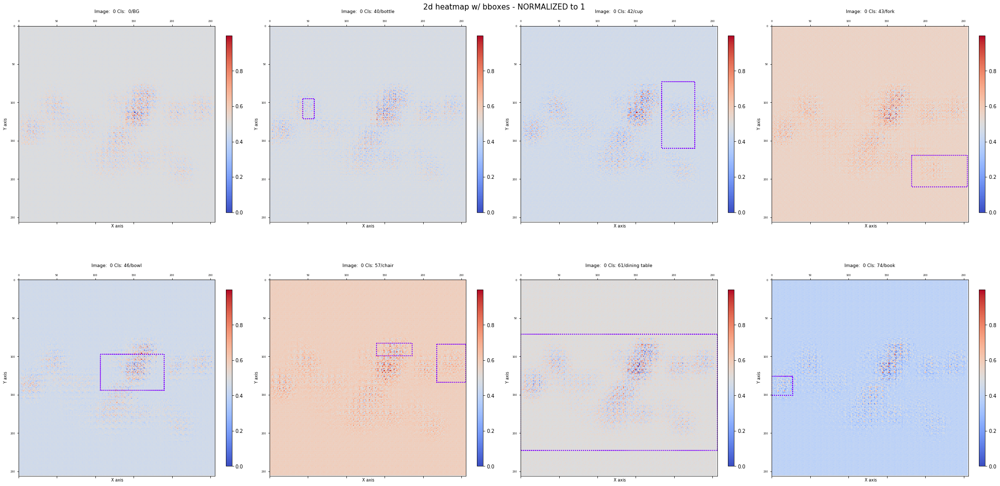

In [18]:
for img_id in [0]:     ##range(mrcnn_config.BATCH_SIZE):
    print(model_fcn_heatmap.shape)
    class_ids = np.unique(model_gt_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
    plot_2d_heatmap(model_fcn_heatmap, model_gt_heatmap_scores,img_id, class_ids, columns = 4,
                                 class_names = coco_class_names, scale = 4, scaling = True)

####  2D plot of `model_fcn_heatmap` returned from model - ALL CLASSES

Image : 0  Pred ClassIds: [0, 14, 40, 42, 43, 46, 49, 55, 56, 57, 61, 74]
            Gt   ClassIds: [0, 40, 42, 43, 46, 57, 61, 74]
Display all classes...
class_ids: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65
 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80]
rows   21  columns : 4


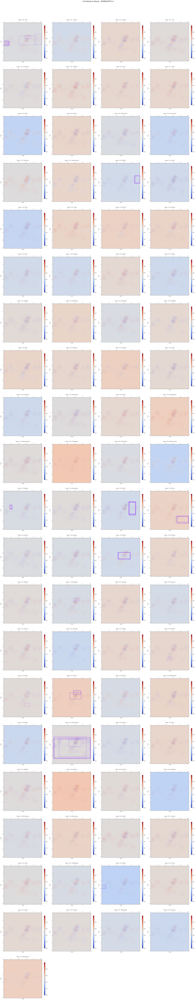

In [23]:
for img_id in [0]: 
    class_ids = np.unique(model_pred_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
    print('Image : {}  Pred ClassIds: {}'.format(img_id, class_ids))
    print('            Gt   ClassIds: {}'.format(np.unique(model_gt_heatmap_scores[img_id,:,:,4]).astype(int).tolist()))
#     plot_2d_heatmap_with_bboxes(model_fcn_heatmap[...,:class_ids[-1]+1], model_gt_heatmap_scores, img_id, 
#                                 class_ids, class_names = class_names, columns = 2, scale = 4)
    fig = plot_2d_heatmap(model_fcn_heatmap, model_pred_heatmap_scores, img_id,
                                class_names = coco_class_names, columns = 4, scale = 4, scaling = True)
#     fig.savefig('fcn_heatmaps_2d.png')

In [ ]:
fig.savefig('fcn_heatmaps_2d.png')

####  2D plot of `pred_heatmap_norm` returned from MRCNN 

(1, 256, 256, 81)
Image : 0  ClassIds: [0, 14, 40, 42, 43, 46, 49, 55, 56, 57, 61, 74]
Display classes: [0, 14, 40, 42, 43, 46, 49, 55, 56, 57, 61, 74]
rows   3  columns : 4


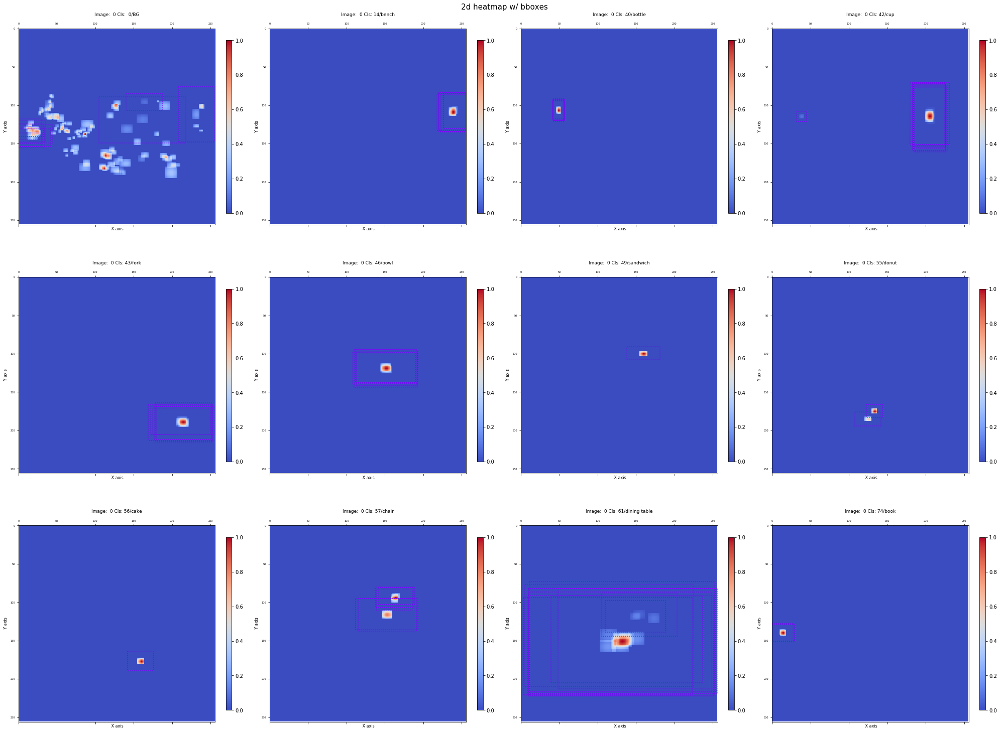

In [24]:
for img_id in [0]: ## range(mrcnn_config.BATCH_SIZE):
    # print(pred_refined_heatmap_scores[img_id,:4])
    print(model_pred_heatmap_norm.shape)
    class_ids = np.unique(model_pred_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
    plot_2d_heatmap(model_pred_heatmap_norm, model_pred_heatmap_scores, img_id, class_ids, 
                                class_names = coco_class_names, columns = 4, scale = 4)

####  2D comparative display `pred_heatmap` / `fcn_heatmap`  

Image : 0  ClassIds: [0, 14, 40, 42, 43, 46, 49, 55, 56, 57, 61, 74]
Display classes: [0, 14, 40, 42, 43, 46, 49, 55, 56, 57, 61, 74]


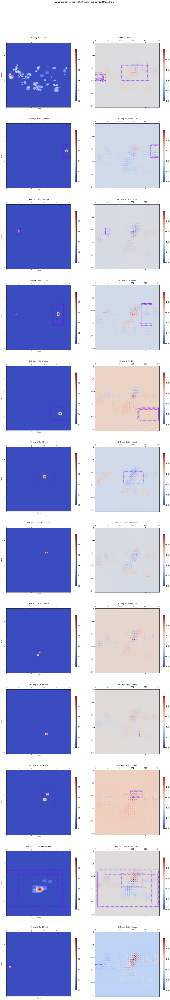

In [26]:
for img_id in [0]: ##range(mrcnn_config.BATCH_SIZE):
    class_ids = np.unique(model_pred_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
#     class_ids = list(range(30))
    plot_2d_heatmap_compare(model_pred_heatmap_norm, model_fcn_heatmap, model_pred_heatmap_scores, img_id, 
                            class_ids = class_ids, class_names = coco_class_names, scale = 4, scaling = True )    

###  3D Plots

####  3D plot of  `gt_heatmap_norm` returned form code above

(1, 256, 256, 81)
Image : 0  ClassIds: [0, 40, 42, 43, 46, 57, 61, 74]
Display classes: [0, 40, 42, 43, 46, 57, 61, 74]
rows   4  columns : 2
zlim = all  min_z: () min_z: 0.0
zlim = all  max_z_all: () max_z: 1.0
zlim = all  min_z_all : 0.00000000 max_z_all: 1.00000000 
zlim = all  min_z_all : 0.00000000 max_z_all: 1.00000000 
zlim = all  min_z_all : 0.00000000 max_z_all: 1.00000000 
zlim = all  min_z_all : 0.00000000 max_z_all: 1.00000000 
zlim = all  min_z_all : 0.00000000 max_z_all: 1.00000000 
zlim = all  min_z_all : 0.00000000 max_z_all: 1.00000000 
zlim = all  min_z_all : 0.00000000 max_z_all: 1.00000000 
zlim = all  min_z_all : 0.00000000 max_z_all: 1.00000000 


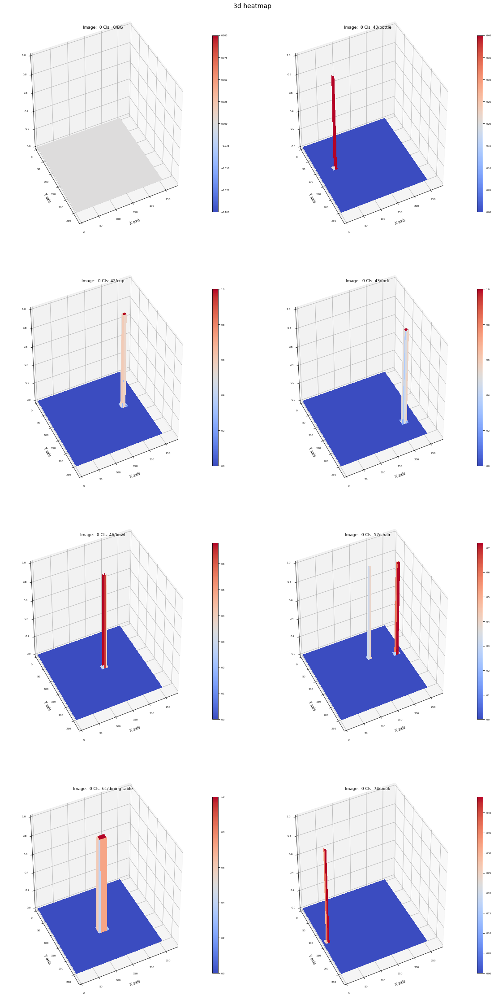

In [32]:
for img_id in [0]: ## range(mrcnn_config.BATCH_SIZE):
    print(model_gt_heatmap.shape)
    class_ids = np.unique(model_gt_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
    plot_3d_heatmap(model_gt_heatmap, img_id, class_ids, class_names = coco_class_names, zlim = 'all')

####  3D plot of `pred_heatmap_norm` returned form model

(1, 256, 256, 81)
Image : 0  ClassIds: [0, 14, 40, 42, 43, 46, 49, 55, 56, 57, 61, 74]
Display classes: [0, 14, 40, 42, 43, 46, 49, 55, 56, 57, 61, 74]
rows   6  columns : 2
zlim = each min_z : 0.00000000 max_z: 1.00000000 
zlim = each min_z : 0.00000000 max_z: 1.00000000 
zlim = each min_z : 0.00000000 max_z: 1.00000000 
zlim = each min_z : 0.00000000 max_z: 1.00000000 
zlim = each min_z : 0.00000000 max_z: 1.00000000 
zlim = each min_z : 0.00000000 max_z: 1.00000000 
zlim = each min_z : 0.00000000 max_z: 1.00000000 
zlim = each min_z : 0.00000000 max_z: 1.00000000 
zlim = each min_z : 0.00000000 max_z: 1.00000000 
zlim = each min_z : 0.00000000 max_z: 1.00000000 
zlim = each min_z : 0.00000000 max_z: 1.00000000 
zlim = each min_z : 0.00000000 max_z: 1.00000000 


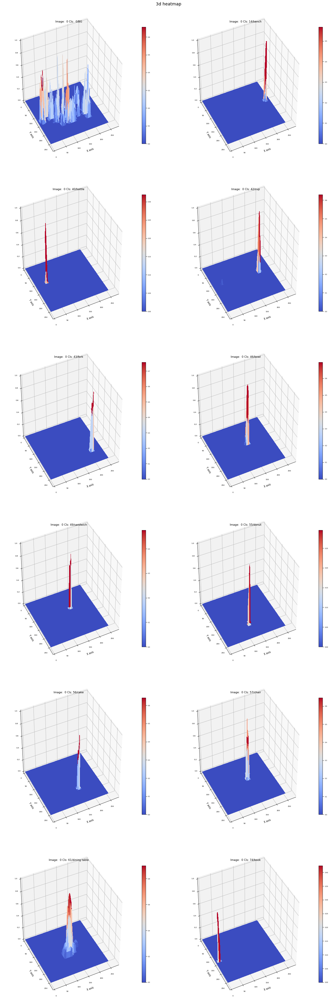

In [35]:
for img_id in [0]: ##range(mrcnn_config.BATCH_SIZE):
    print(model_pred_heatmap_norm.shape)
    class_ids = np.unique(model_pred_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
    plot_3d_heatmap(model_pred_heatmap_norm, img_id, class_ids, class_names = coco_class_names, zlim = 'each' )

####  3D plot of `fcn_heatmap` returned form model - only classes in pred_scores

In [36]:
print(np.max(model_fcn_heatmap), np.min(model_fcn_heatmap))

0.0032794783 -0.0029422848


(1, 256, 256, 81)
Image : 0  ClassIds: [0, 14, 40, 42, 43, 46, 49, 55, 56, 57, 61, 74]
Display classes: [0, 14, 40, 42, 43, 46, 49, 55, 56, 57, 61, 74]
rows   6  columns : 2
zlim = all  min_z: () min_z: -0.0029422848
zlim = all  max_z_all: () max_z: 0.0032794783
zlim = all  min_z_all : -0.00294228 max_z_all: 0.00327948 
zlim = all  min_z_all : -0.00294228 max_z_all: 0.00327948 
zlim = all  min_z_all : -0.00294228 max_z_all: 0.00327948 
zlim = all  min_z_all : -0.00294228 max_z_all: 0.00327948 
zlim = all  min_z_all : -0.00294228 max_z_all: 0.00327948 
zlim = all  min_z_all : -0.00294228 max_z_all: 0.00327948 
zlim = all  min_z_all : -0.00294228 max_z_all: 0.00327948 
zlim = all  min_z_all : -0.00294228 max_z_all: 0.00327948 
zlim = all  min_z_all : -0.00294228 max_z_all: 0.00327948 
zlim = all  min_z_all : -0.00294228 max_z_all: 0.00327948 
zlim = all  min_z_all : -0.00294228 max_z_all: 0.00327948 
zlim = all  min_z_all : -0.00294228 max_z_all: 0.00327948 


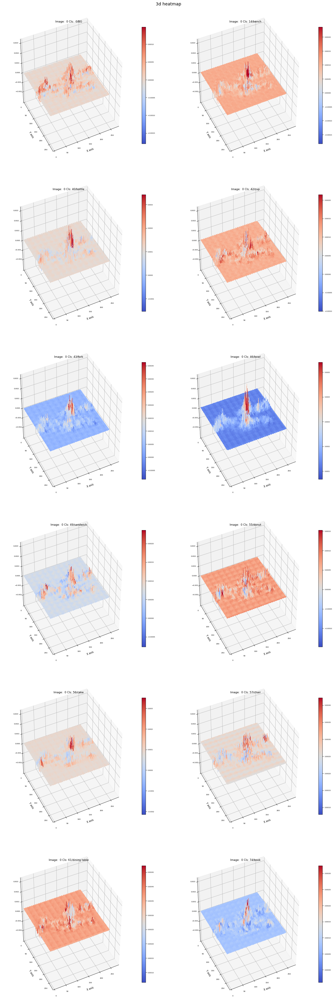

In [37]:
for img_id in [0]: ##range(mrcnn_config.BATCH_SIZE):
    print(model_fcn_heatmap.shape)
    class_ids = np.unique(model_pred_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
    plot_3d_heatmap(model_fcn_heatmap, img_id, class_ids,class_names = coco_class_names, scaling = False)

####  3D plot of `fcn_heatmap` returned form model - all classes

In [ ]:
for img_id in [0]: ##range(mrcnn_config.BATCH_SIZE):
    class_ids = np.unique(model_pred_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
#     plot_3d_heatmap(model_fcn_heatmap, img_id, class_ids,class_names = class_names, size = (8,8), zlim=0)
#     plot_3d_heatmap_all_classes(model_fcn_heatmap[...,:class_ids[-1]+1], img_id, class_names = class_names, size = (8,8), zlim=0.0)
    plot_3d_heatmap(model_fcn_heatmap, img_id, class_names = class_names, columns = 2,scaling = True)

####  3D comparative display `pred_heatmap` / `fcn_heatmap` 

In [ ]:
for img_id in [0]: ##range(mrcnn_config.BATCH_SIZE):
    print(model_pred_heatmap_norm.shape)
    class_ids = np.unique(model_pred_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
    class_ids.append(1)
    class_ids = list(range(30))
#     print(class_ids)
    plot_3d_heatmap_compare(model_pred_heatmap_norm,model_fcn_heatmap, img_id, class_ids = class_ids, 
                            class_names = class_names, size=(8,8), zlim = 'all' , scaling = True)

####  3D comparative display `gt_heatmap` / `fcn_heatmap` 

In [ ]:
for img_id in [0]: ##range(mrcnn_config.BATCH_SIZE):
    class_ids = np.unique(model_gt_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
    class_ids.extend([1,2])
    print(class_ids)
    print(type(class_ids))
    class_ids.sort()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
    plot_3d_heatmap_compare(model_gt_heatmap,model_fcn_heatmap, img_id, class_ids, class_names = class_names, size=(8,8), zlim = 0 )

### Overlay predictions on image

#### Overlay image with gt_heatmaps

(1, 81, 200, 11)
class ids:  [0, 40, 42, 43, 46, 57, 61, 74]
Image shape : (1024, 1024, 3)  class_ids: [0, 40, 42, 43, 46, 57, 61, 74]
heatmaps shape: (256, 256, 81) bboxes shape : (81, 200, 4)
1- image    :  (1024, 1024, 3) float32 -123.7 151.1
2- image    :  (1024, 1024, 3) uint8 0 255


/home/kbardool/anaconda3/envs/TFG/lib/python3.5/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/home/kbardool/anaconda3/envs/TFG/lib/python3.5/site-packages/skimage/util/dtype.py:122: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


3- image    :  (480, 640, 3) uint8 0 253
5- image_bw:  (480, 640) uint8 0 251
 boxes_to_image_domain() 
    Original image shape : [480 640   3]   Image window info: [ 128    0  896 1024] 
    Adjustment scale     : [0.625 0.625 0.625 0.625]   Adjustment shift : [128   0] 
    Adjusted boxes shape : (81, 200, 4) 


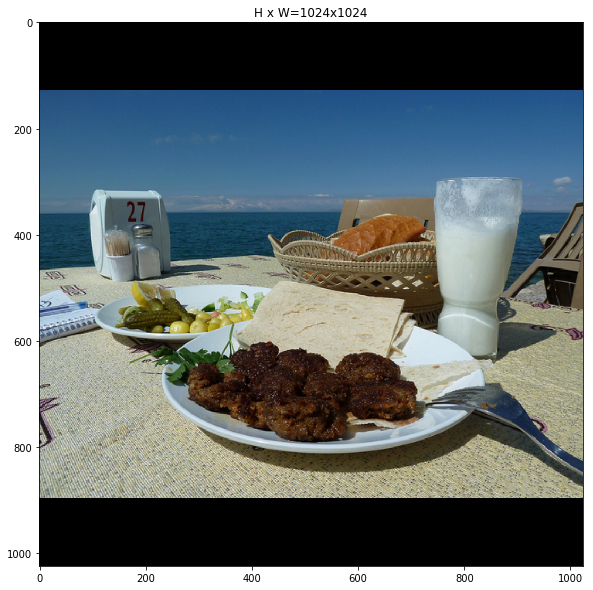

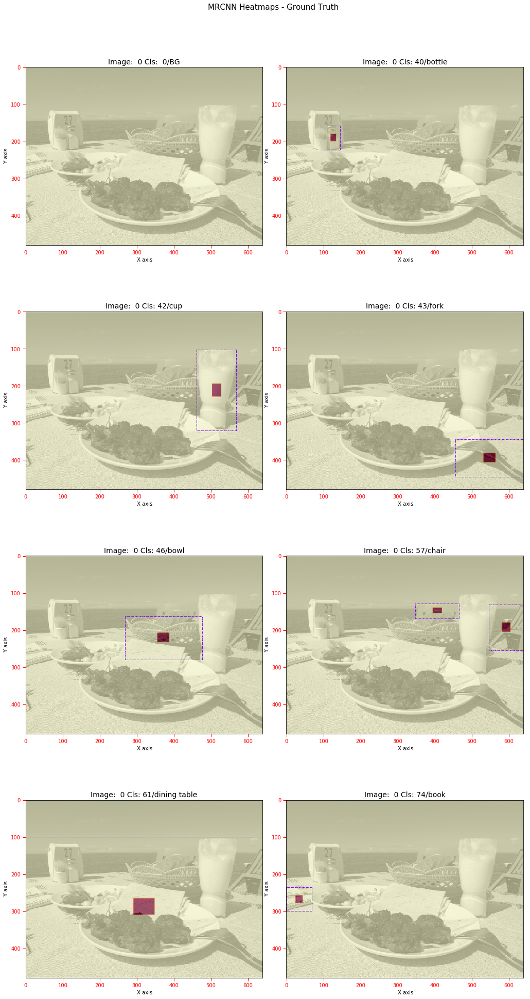

In [38]:
from mrcnn.visualize import display_heatmaps, display_heatmaps_fcn, display_heatmaps_mrcnn
# visualize.display_image_bw(image)
print(model_gt_heatmap_scores.shape)
class_ids = np.unique(model_gt_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
print('class ids: ', class_ids)
display_heatmaps_mrcnn(train_batch_x, model_output, 0, hm = 'gt',
                     config = mrcnn_config, class_ids = class_ids, class_names = coco_class_names)

#### Overlay image with pred_heatmaps

In [ ]:
from mrcnn.visualize import display_heatmaps, display_heatmaps_fcn, display_heatmaps_mrcnn
# visualize.display_image_bw(image)
print(model_gt_heatmap_scores.shape)
class_ids = np.unique(model_gt_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
print('class ids: ', class_ids)
display_heatmaps_mrcnn(train_batch_x, model_output, 0, hm = 'pr', num_bboxes = 0,
                     config = mrcnn_config, class_ids = class_ids, class_names = coco_class_names)

#### Overlay image with fcn_heatmaps

[0, 40, 42, 43, 46, 57, 61, 74]
Image shape : (1024, 1024, 3)  class_ids: [0, 40, 42, 43, 46, 57, 61, 74]
1- image    :  (1024, 1024, 3) float32 -123.7 151.1
2- image    :  (1024, 1024, 3) uint8 0 255
3- image    :  (480, 640, 3) uint8 0 253
4- image_bw:  (480, 640) uint8 0 251
 boxes_to_image_domain() 
    Original image shape : [480 640   3]   Image window info: [ 128    0  896 1024] 
    Adjustment scale     : [0.625 0.625 0.625 0.625]   Adjustment shift : [128   0] 
    Adjusted boxes shape : (81, 200, 4) 


/home/kbardool/anaconda3/envs/TFG/lib/python3.5/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/home/kbardool/anaconda3/envs/TFG/lib/python3.5/site-packages/skimage/util/dtype.py:122: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


 Heatmap after scaling to 1 : class: 0   min:0.0, max:0.9997164091768221
 Heatmap after scaling to 1 : class: 40   min:0.0, max:0.9996803942895381
 Heatmap after scaling to 1 : class: 42   min:0.0, max:0.9996886847041493
 Heatmap after scaling to 1 : class: 43   min:0.0, max:0.999679590594603
 Heatmap after scaling to 1 : class: 46   min:0.0, max:0.9997294382303868
 Heatmap after scaling to 1 : class: 57   min:0.0, max:0.9997089869978218
 Heatmap after scaling to 1 : class: 61   min:0.0, max:0.9996423773850043
 Heatmap after scaling to 1 : class: 74   min:0.0, max:0.999695049199642


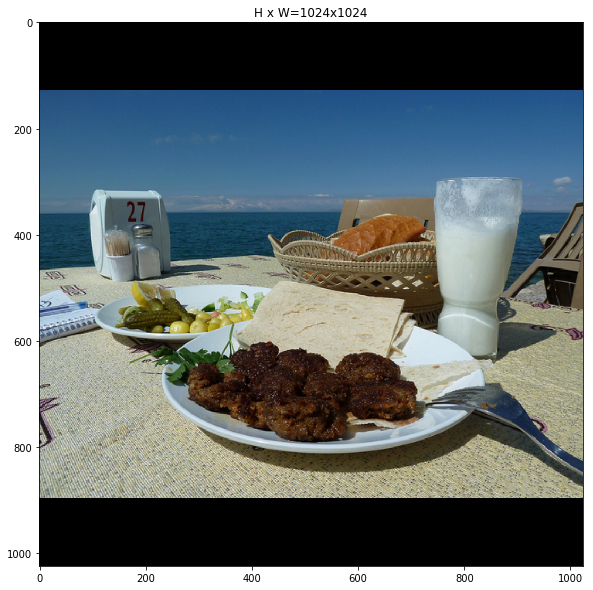

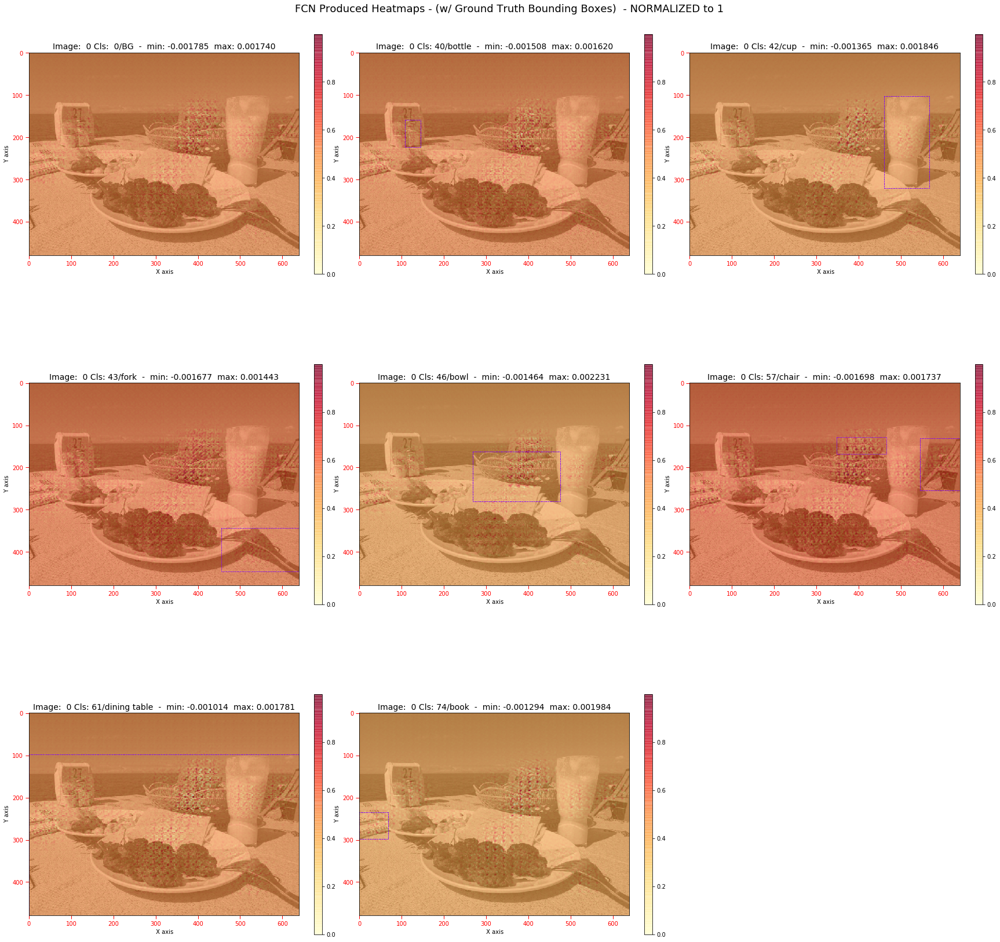

In [58]:
from mrcnn.visualize import display_heatmaps, display_heatmaps_mrcnn_fcn
# visualize.display_image_bw(image)
class_ids = np.unique(model_gt_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
print(class_ids)
display_heatmaps_mrcnn_fcn(train_batch_x, fcn_train_batch_x, 0, heatmap = model_fcn_heatmap, hm = 'gt', columns = 3,
                     config = mrcnn_config, class_ids = class_ids, class_names = coco_class_names, scaling = True)

##  Display `gauss_heatmap` 3D heatmap (not normalized, normlized, L2 normalized)

In [ ]:
from mrcnn.visualize import plot_3d_heatmap, plot_2d_heatmap, plot_3d_gaussian
%matplotlib inline
print('Image id: ',image_id , '    Classes (1: circle, 2: square, 3: triangle ): ')
img = 0
cls = 0
# print(pred_heatmap_scores[img,cls,:10])

# ttl = 'Non-normalized - image: {}'.format(img)
# plot_3d_heatmap(pred_heatmap[img], title = ttl, width = 20)
# ttl = 'Normalized - image: {}'.format(img)
# plot_3d_heatmap(pred_heatmap_norm[img], title = ttl, width = 20)

# ttl = 'Non-normalized - image: {}'.format(img)
# plot_3d_heatmap(fcn_heatmap[img], title = ttl, width = 20)
# ttl = 'Normalized - image: {}'.format(img)
# plot_3d_heatmap(fcn_heatmap_norm[img], title = ttl, width = 20)

ttl = 'Ground Truth Non-normalized - image: {}'.format(img)
# plot_3d_gaussian(model_fcn_heatmap[img,:,:,1], title = ttl, width = 10)
# ttl = 'Ground Truth Normalized - image: {}'.format(img)
plot_3d_heatmap(model_fcn_heatmap, 0,[9], title = ttl,width = 10, height=10, zlim=1.0005)


# ttl = 'Non-normalized - image: {}'.format(img)
# plot_2d_heatmap(pred_heatmap[img], pred_heatmap_scores[img], width=15, title=ttl)
# ttl = 'Normalized - image: {}'.format(img)
# plot_2d_heatmap(pred_heatmap_norm[img], pred_heatmap_scores[img], width=15, title=ttl)


In [ ]:
from mrcnn.visualize import plot_3d_heatmap, plot_2d_heatmap
%matplotlib inline
img = 0
cls = 1
# print(pred_heatmap_scores[img,cls,:10])

# ttl = 'Non-normalized - image: {}'.format(img)
# plot_3d_heatmap(pred_heatmap[img], title = ttl, width = 20)
# ttl = 'Normalized - image: {}'.format(img)
# plot_3d_heatmap(pred_heatmap_norm[img], title = ttl, width = 20)

# ttl = 'Non-normalized - image: {}'.format(img)
# plot_3d_heatmap(fcn_heatmap[img], title = ttl, width = 20)
# ttl = 'Normalized - image: {}'.format(img)
# plot_3d_heatmap(fcn_heatmap_norm[img], title = ttl, width = 20)

ttl = 'FCN - image: {}'.format(img)
plot_3d_heatmap(model_fcn_heatmap, 0,[9], title = ttl, size = (10,10))
ttl = 'Ground Truth Normalized - image: {}'.format(img)
plot_3d_heatmap(model_gt_heatmap,0,[9], title = ttl, size = (10,10))
